In [221]:
using Plots
using JLD2
using LaTeXStrings
using ColorTypes

In [222]:
include("parameters.jl")
using .MyParams

Load data

In [223]:
script_dir = @__DIR__
plot_folder = joinpath(script_dir, "plots")
if !isdir(plot_folder)
    mkdir(plot_folder)
end

In [248]:
dephasing = 20

20

In [259]:
data_dict = Dict()
for Ω in MyParams.Ω_values
    file_name = "results_data/Δ=$(MyParams.Δ),γ=$(MyParams.γ)/sz_mean_steady_for_$(MyParams.case)D,Ω=$(Ω),Δ=$(MyParams.Δ),γ=$(dephasing).jld2"
    data_dict[Ω] = load(file_name)
end

Plots

In [260]:
default(dpi=300)

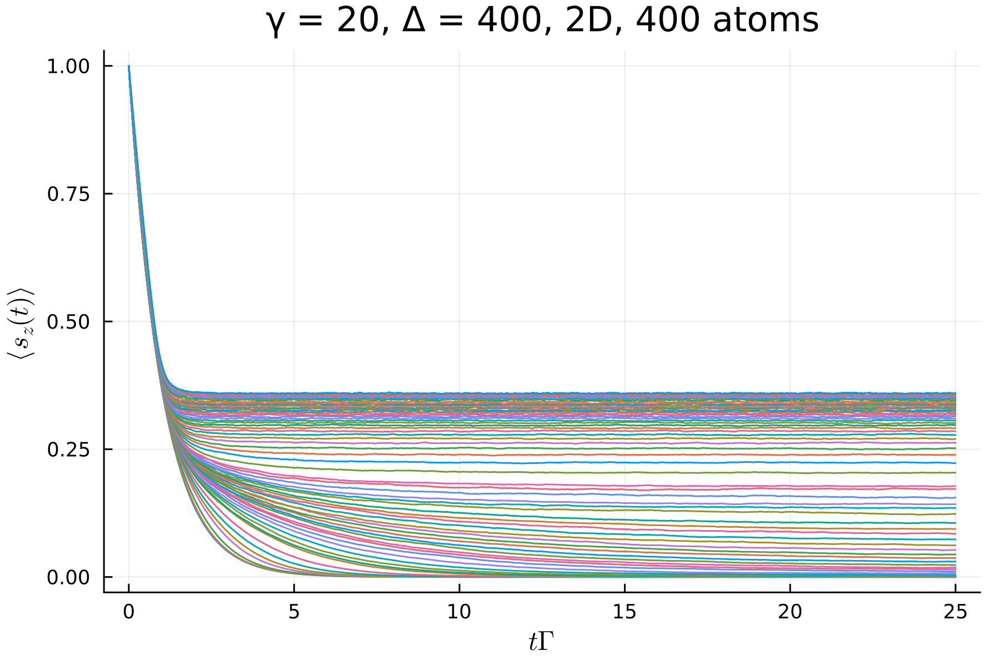

In [261]:
p1 = plot(
    legend=false
)
for Ω in MyParams.Ω_values
    data = data_dict[Ω]
    t = data["t"]
    sz_mean_mean = vec(data["sz_mean_mean"])
    plot!(p1, t, sz_mean_mean, label="Ω=$(Ω)")
end
xlabel!(p1, L"t \Gamma")
ylabel!(p1, L"\langle s_z(t) \rangle")
title!(p1, "\\gamma = $(MyParams.γ), Δ = $(MyParams.Δ), $(MyParams.case)D, $(MyParams.nAtoms) atoms")
display(p1)
# savefig("plots/dynamic_rydberg_facilitation_$(MyParams.case)D,$(MyParams.nAtoms) 
# atoms, γ = $(MyParams.γ), Δ = $(MyParams.Δ).png")

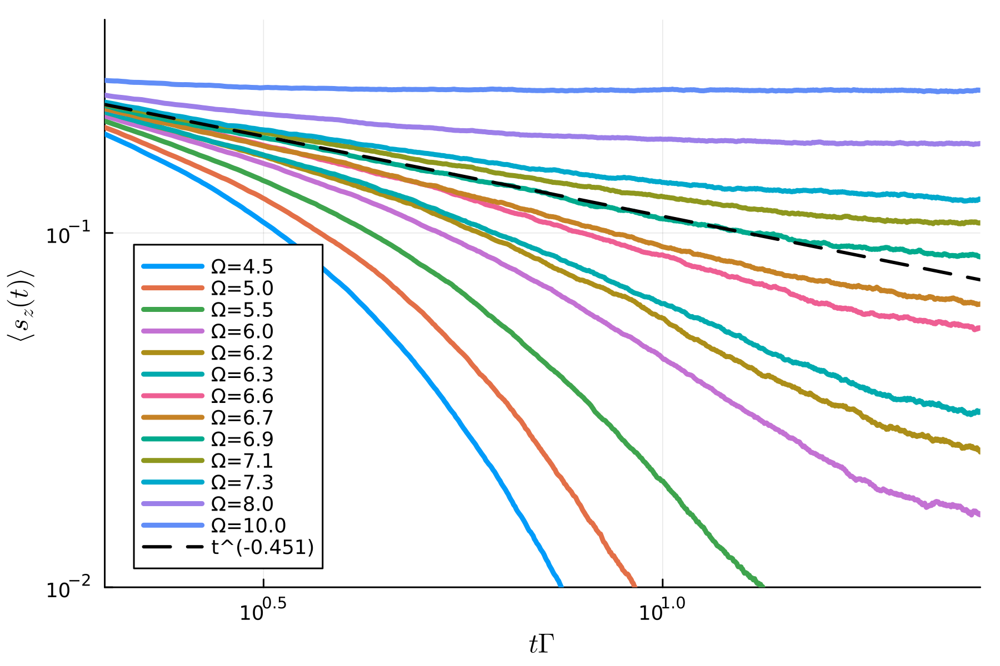

In [262]:
p6 = plot(
    xscale=:log10,
    yscale=:log10,
    legend=:bottomleft,
    xlim=[2,25],
    ylim=[0.01,0.4]
)

Ω_subset = [4.5, 5, 5.5, 6, 6.2, 6.3, 6.6, 6.7, 6.9, 7.1, 7.3, 8, 10]
for Ω in Ω_subset
    data = data_dict[Ω]
    t = data["t"]
    sz_mean_mean = vec(data["sz_mean_mean"])
    plot!(p6, t, sz_mean_mean .+ 1e-3, label="Ω=$(Ω)", linewidth=3)
end

t = data_dict[Ω_subset[1]]["t"]
dash_line = t .^ (-MyParams.delta) .* 0.315
plot!(p6, t, dash_line,
    linestyle=:dash, 
    color=:black, 
    linewidth=2, 
    label="t^(-$(MyParams.delta))")

xlabel!(p6, L"t \Gamma")
ylabel!(p6, L"\langle s_z(t) \rangle")
display(p6)

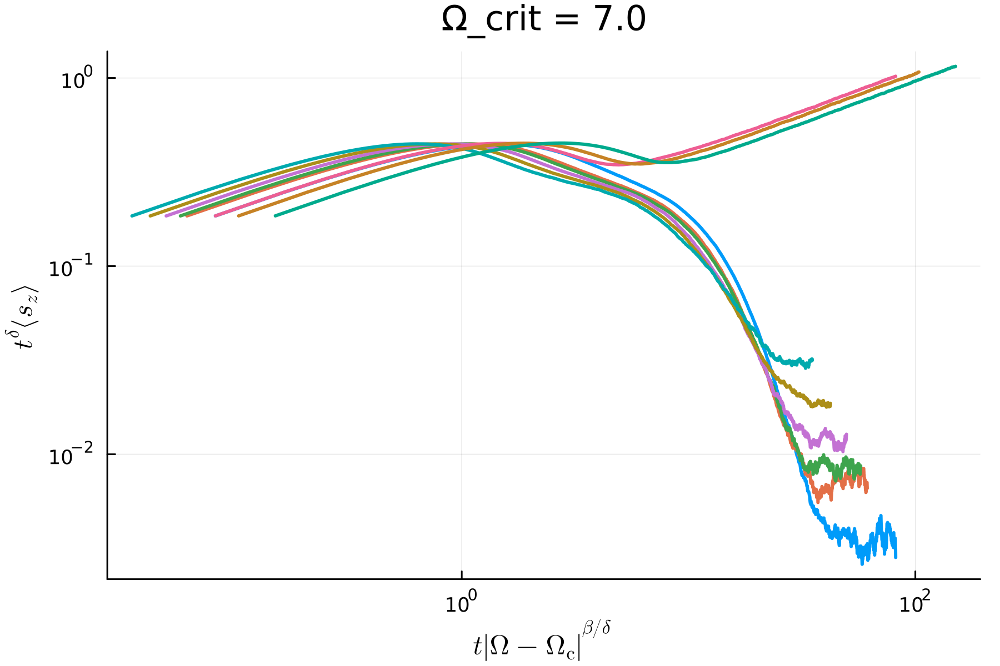

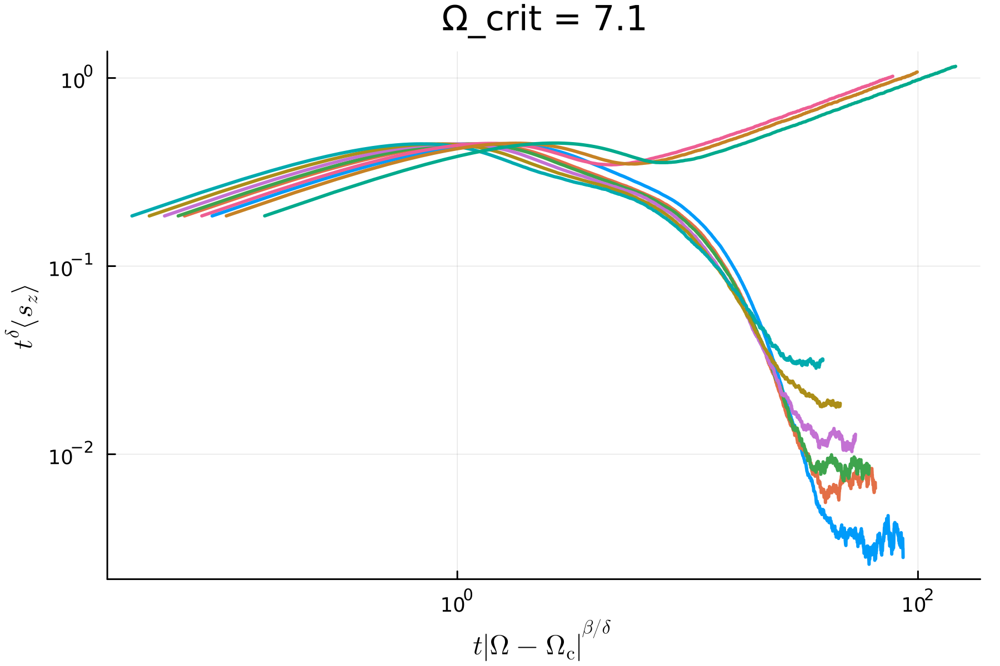

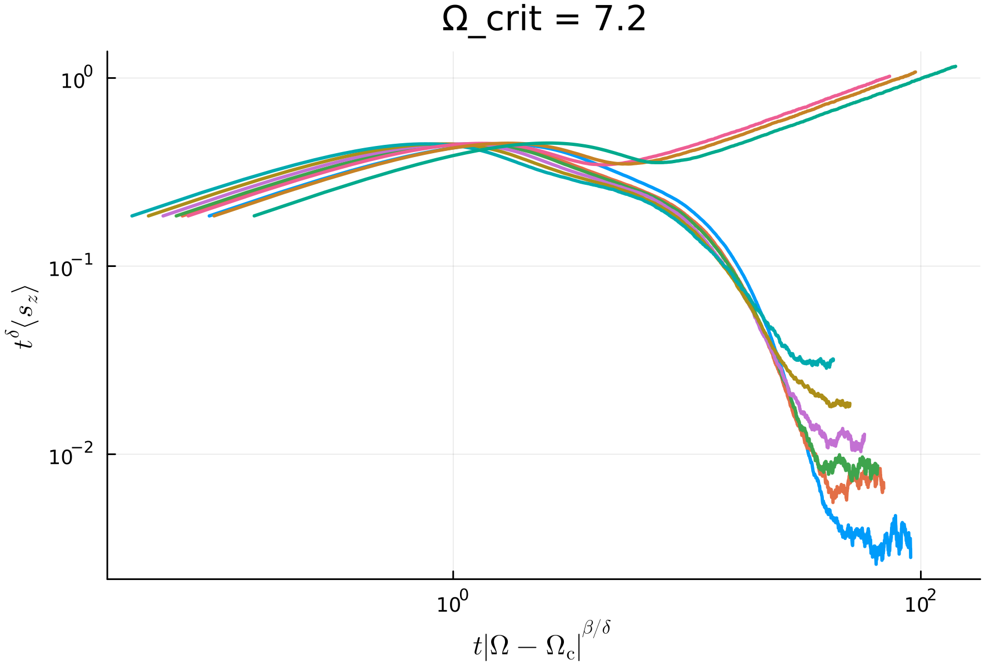

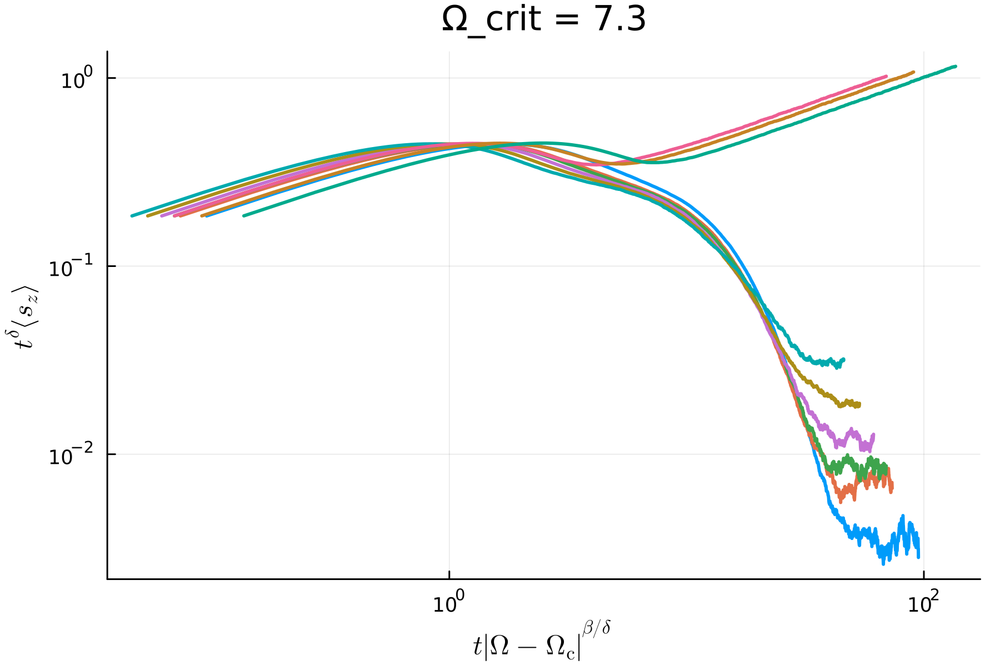

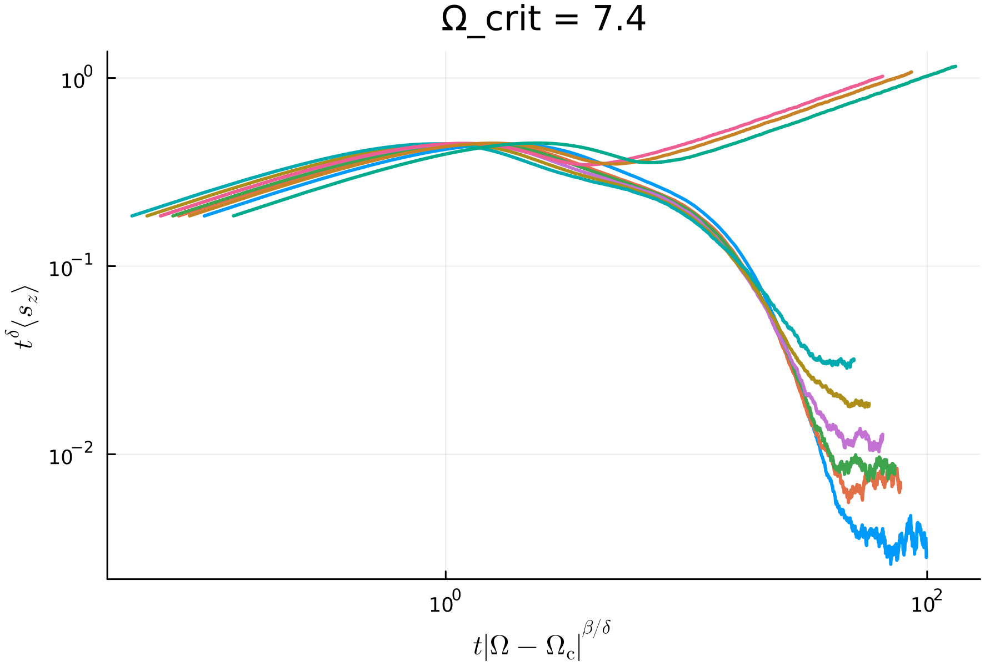

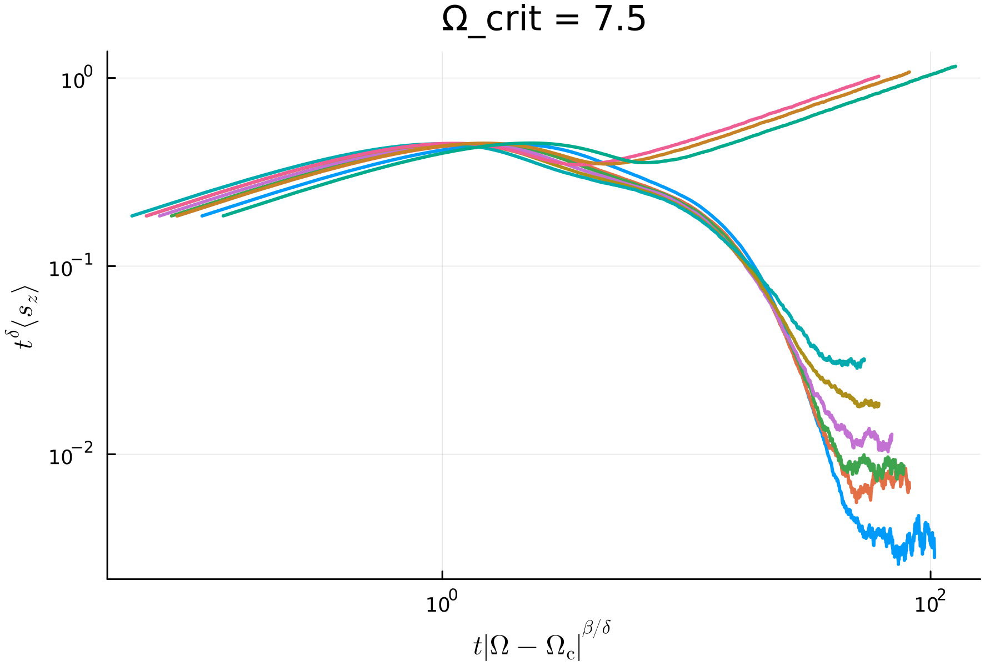

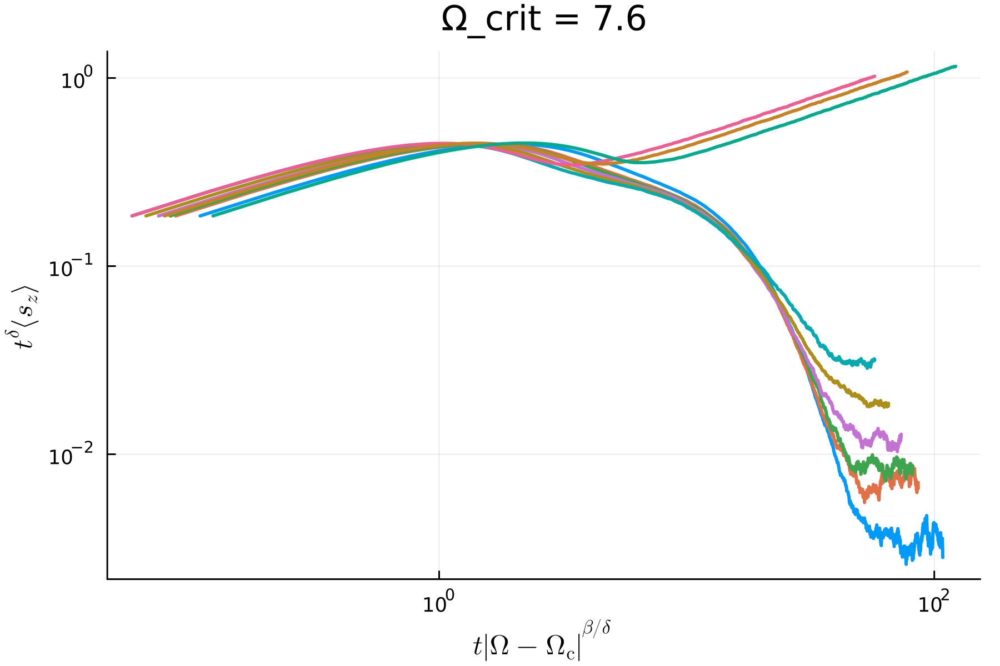

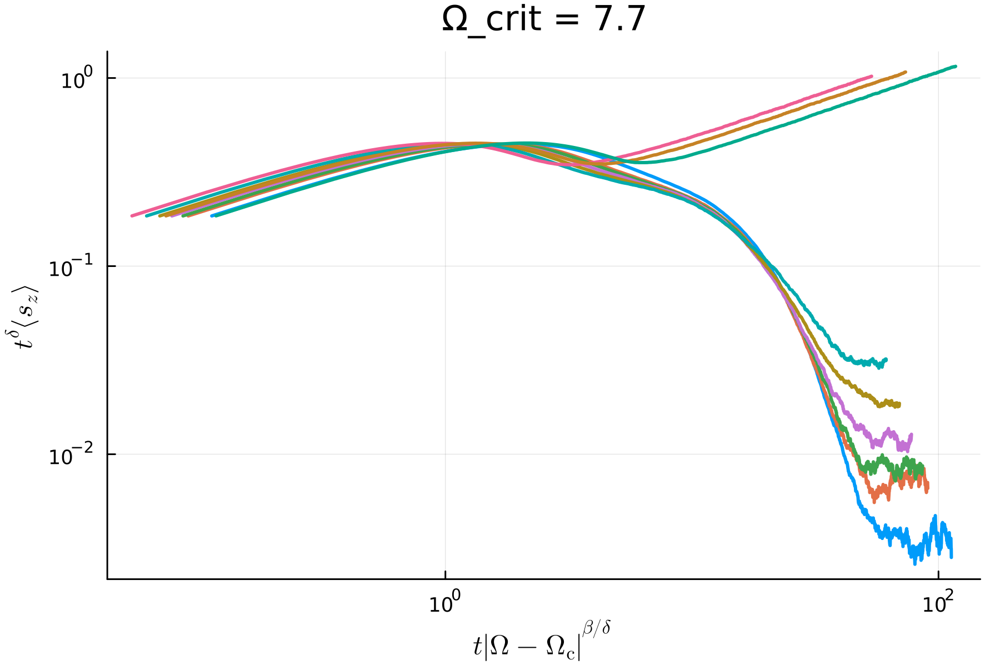

In [263]:
for Ω_crit in 7:0.1:7.7
    p5 = plot(
        xscale=:log10, 
        yscale=:log10,
        legend=false,
        xlabel=L"t |\Omega - \Omega_{\mathrm{c}}|^{\beta/\delta}",
        ylabel=L"t^\delta \langle s_z \rangle",
        title="Ω_crit = $Ω_crit"
    )

    selected_Ω = [4.5, 5, 5.1, 5.3, 5.5, 5.7, 9.5, 10, 11]

    for Ω in selected_Ω
        data = data_dict[Ω]
        t = data["t"]
        sz_mean_mean = vec(data["sz_mean_mean"])

        # Filter valid data points
        valid_indices = (t .> 0) .&& (sz_mean_mean .> 0)
        t_valid = t[valid_indices]
        sz_valid = sz_mean_mean[valid_indices]
        
        isempty(t_valid) && continue

        # Calculate scaled coordinates
        scaling_factor = abs(Ω - Ω_crit)^(MyParams.beta / MyParams.delta) 
        #beta/delta might be different in the coherent regime
        x_scaled = t_valid .* scaling_factor
        y_scaled = (t_valid .^ MyParams.delta) .* sz_valid

        # Filter positive values
        final_indices = (x_scaled .> 0) .&& (y_scaled .> 0)
        x_plot = x_scaled[final_indices]
        y_plot = y_scaled[final_indices]

        !isempty(x_plot) && plot!(p5, x_plot, y_plot, linewidth=2)
    end
    
    display(p5)
end

Omega vs. sz

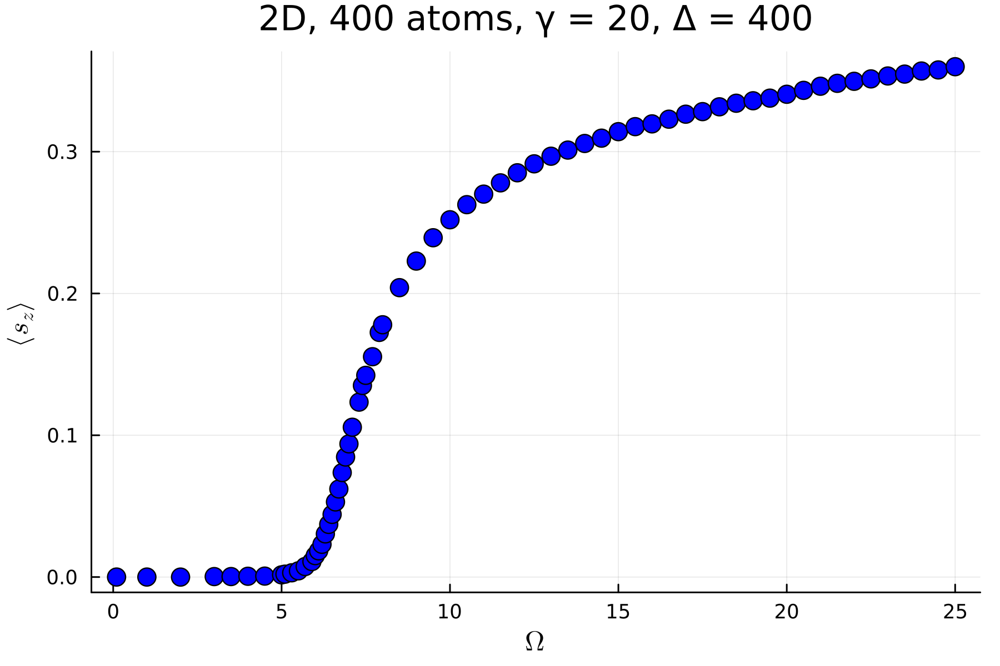

In [264]:
p2 = plot()
final_sz_values = Float64[]
Ωvalues = Float64[]

for Ω in MyParams.Ω_values
    if Ω in (0.1,1,2,3,3.5,4,4.5,5,5.1,5.3,5.5,5.7,5.9,6,6.1,6.2,6.25,6.3,
        6.4,6.45,6.5,6.6,6.65,6.7,6.8,6.85,6.9,7,7.1,7.15,7.3,7.4,7.45,7.5,7.7,
        7.9,8,8.5,9,9.5,10,10.5,11,11.5,12,12.5,13,13.5,14,14.5,15,15.5,16,16.5,
        17,17.5,18,18.5,19,19.5,20,20.5,21,21.5,22,22.5,23,23.5,24,24.5,25)
        data = data_dict[Ω]
        t = data["t"]
        sz_mean_mean = vec(data["sz_mean_mean"])
        push!(final_sz_values, last(sz_mean_mean))
        push!(Ωvalues, Ω)
    end
end
scatter!(
    Ωvalues, final_sz_values,
    xlabel=L"\Omega", 
    ylabel=L"\langle s_z \rangle",
    title="$(MyParams.case)D, $(MyParams.nAtoms) atoms, γ = $(MyParams.γ), Δ = $(MyParams.Δ)",
    marker=:circle, markersize=6, color=:blue,
    linestyle=:auto, legend=:topright, label=false
)
#vline!([Ω_crit], color=:black, linestyle=:dash, linewidth=2,label=false)
display(p2)
# savefig("plots/steady_state_rydberg_density_$(MyParams.case)D,$(MyParams.nAtoms) atoms, γ = $(MyParams.γ), Δ = $(MyParams.Δ).png")

ln|Ω_values .- Ω_crit| vs. ln(<'Sz'>)

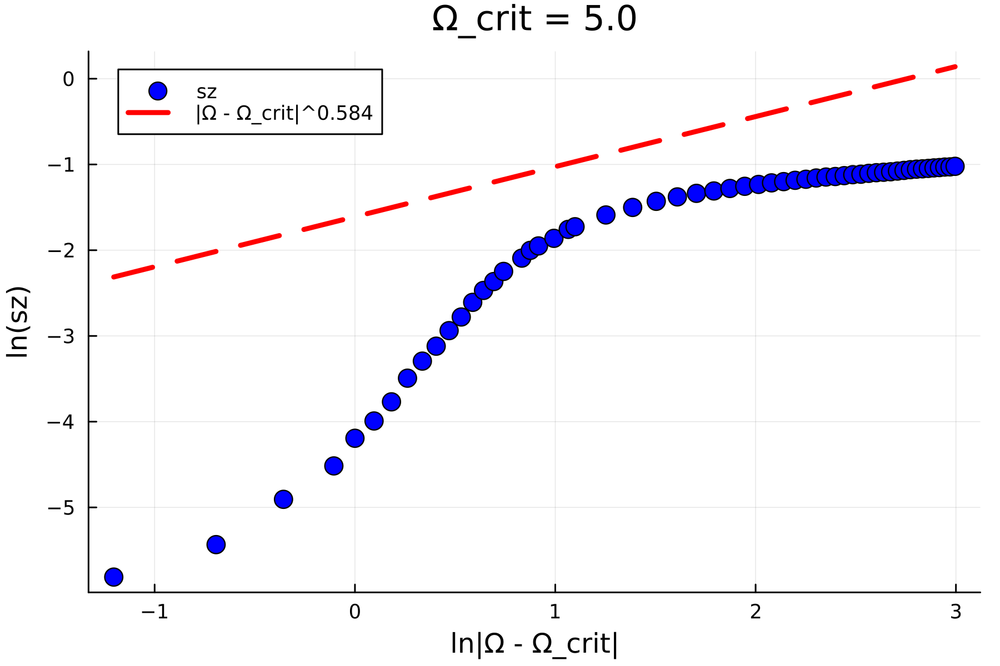

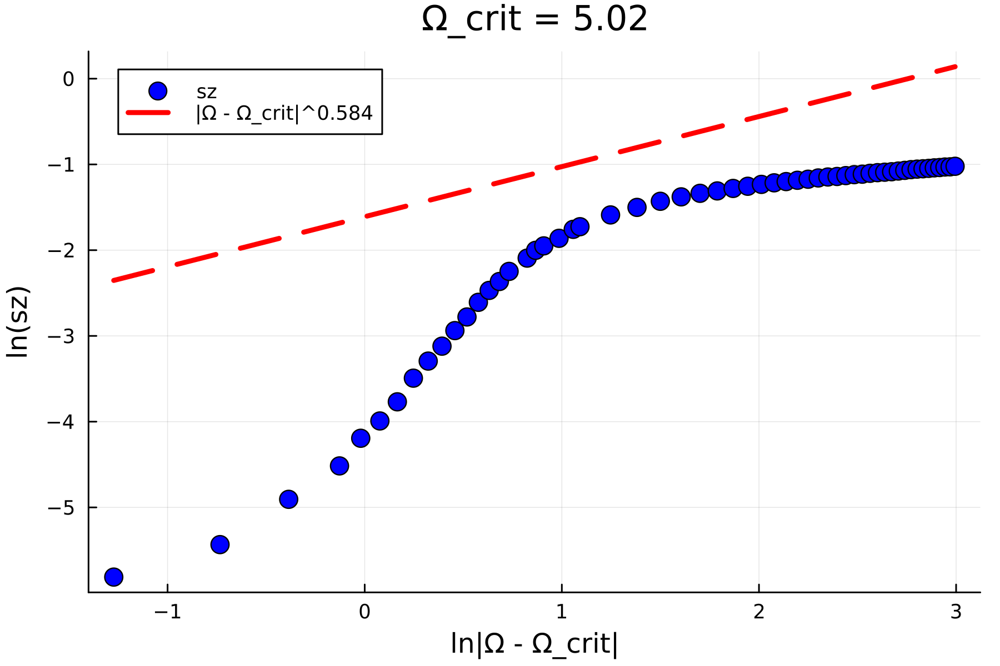

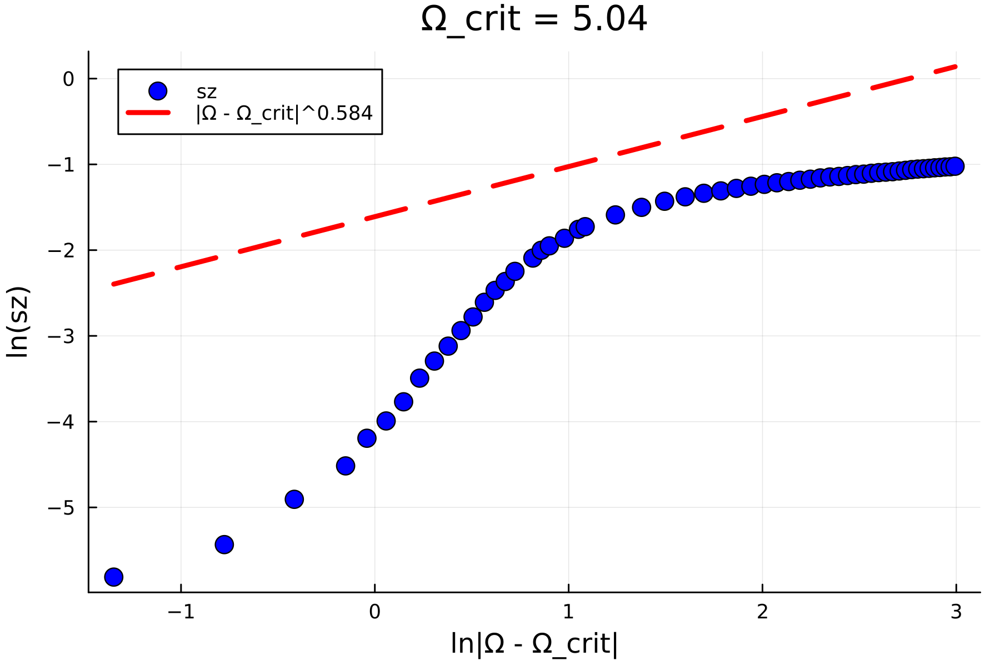

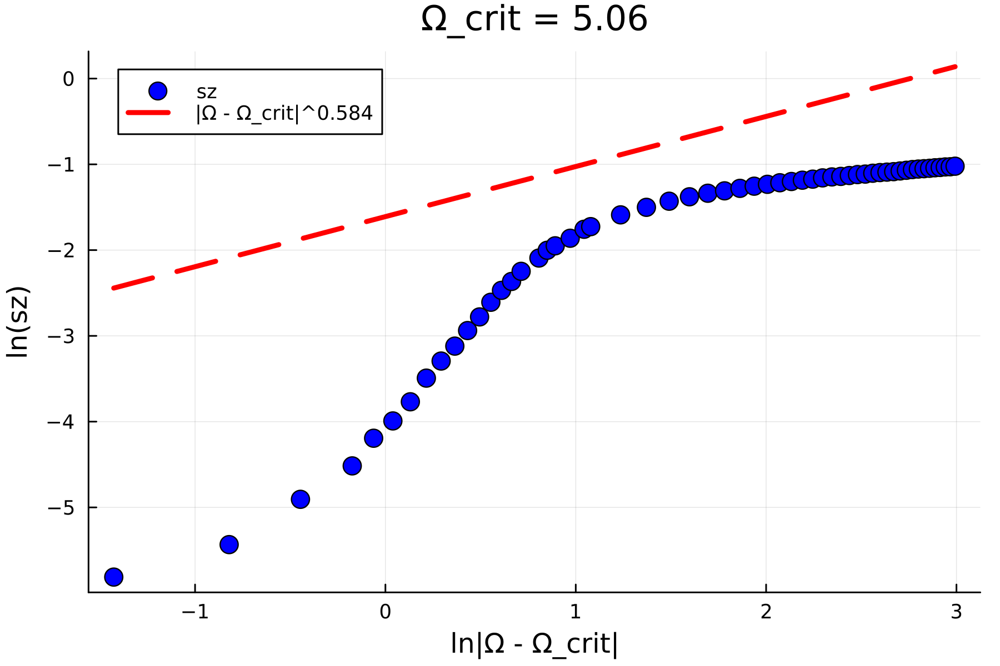

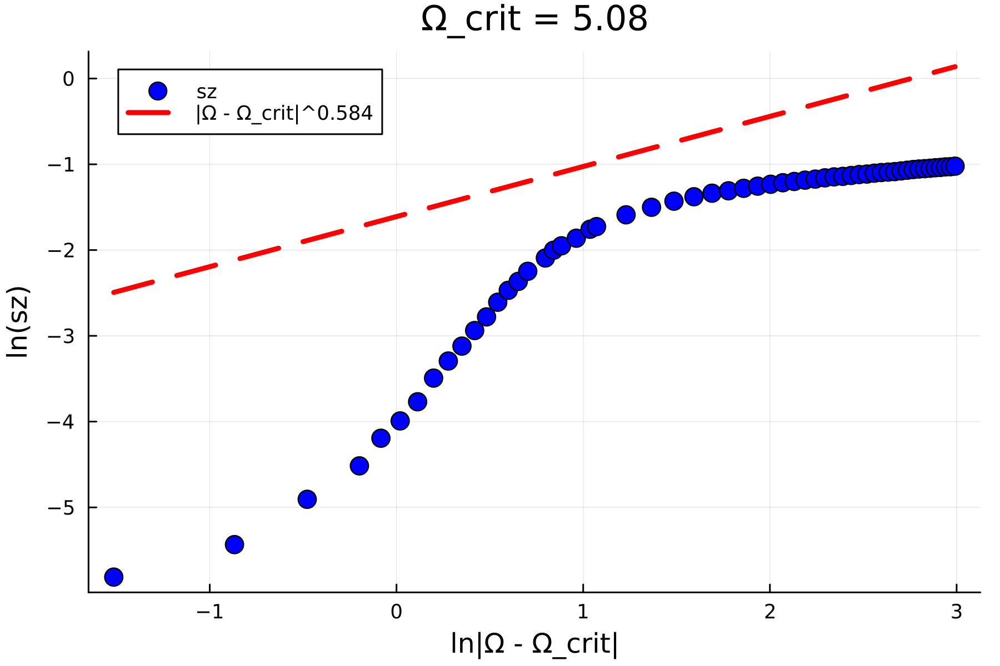

...

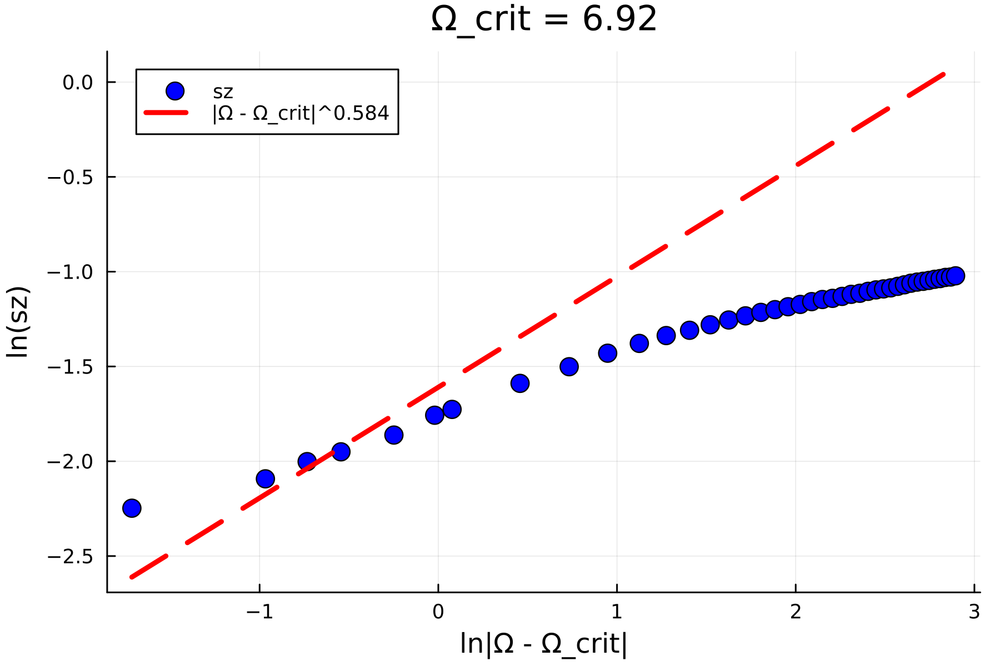

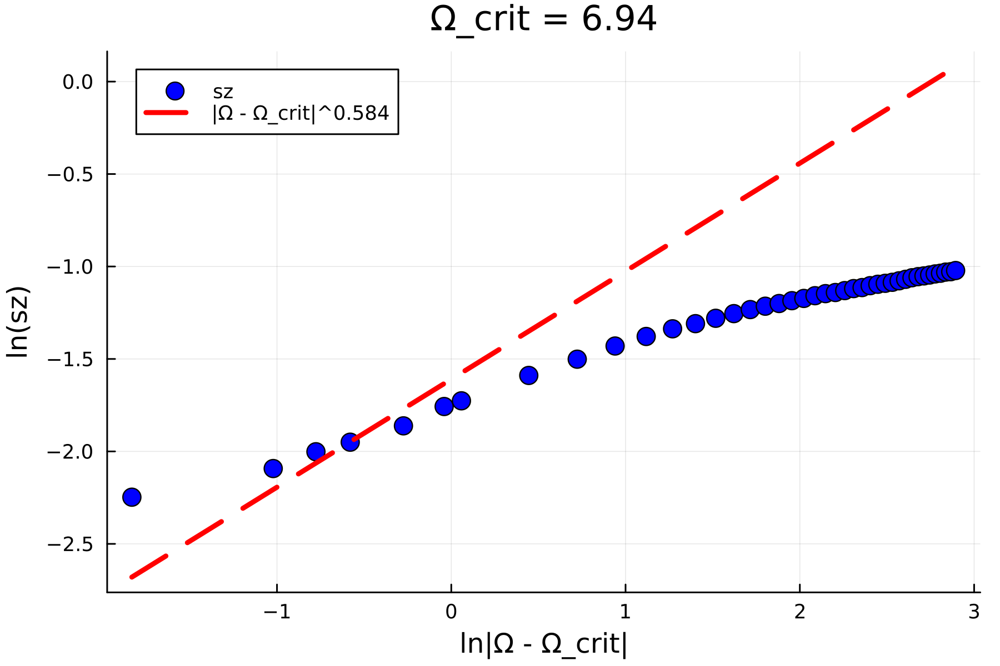

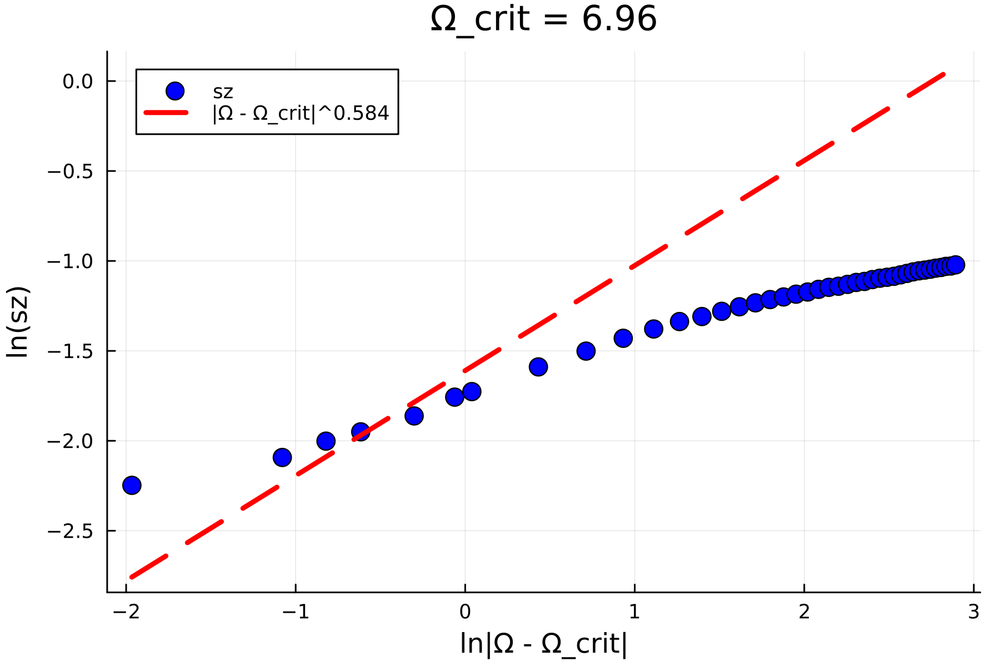

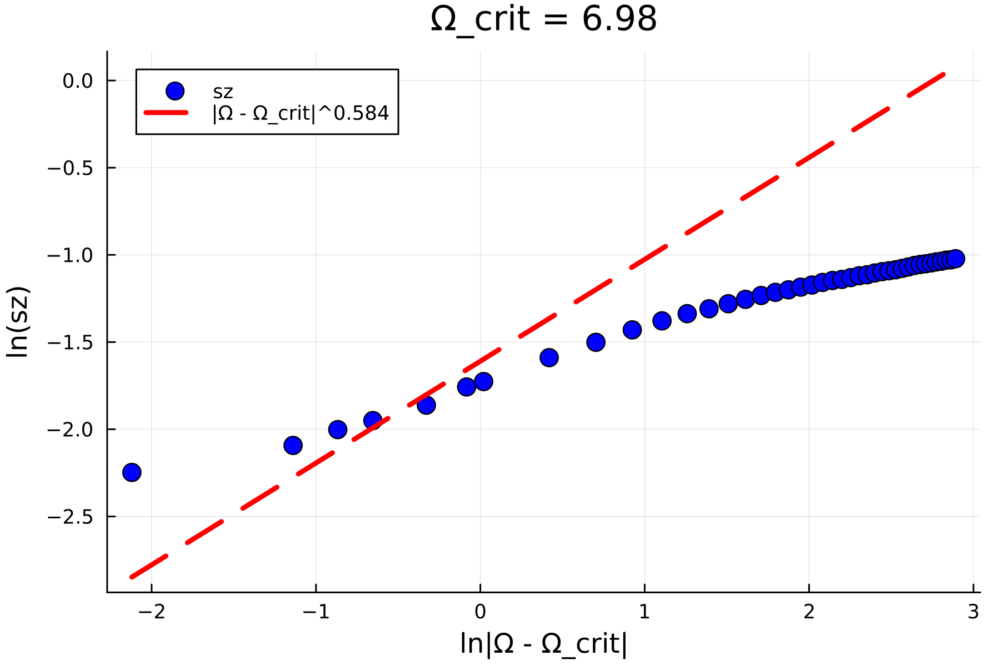

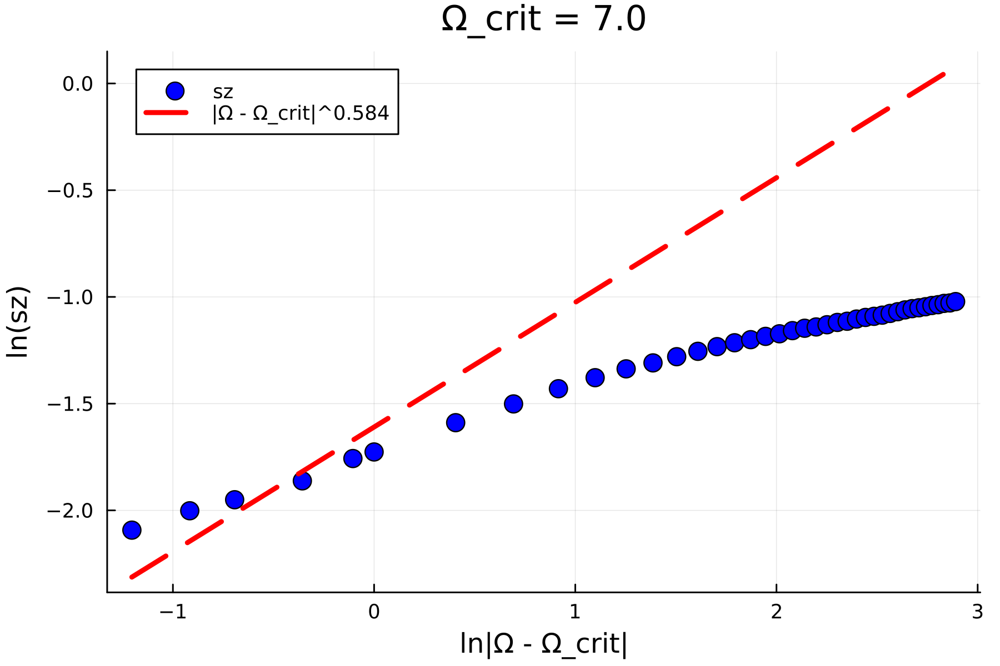

In [265]:
Ω_crit_values = 5:0.02:7
fixed_beta = MyParams.beta
prefactor = 0.2

for Ω_crit in Ω_crit_values
    # Filter Ω values and calculate sz values
    valid_indices = [Ω - Ω_crit > 0.1 for Ω in MyParams.Ω_values]
    filtered_Ω_values = MyParams.Ω_values[valid_indices]
    
    final_sz_values = [last(vec(data_dict[Ω]["sz_mean_mean"])) for Ω in filtered_Ω_values]

    # Calculate logarithmic values
    xaxis = log.(abs.(filtered_Ω_values .- Ω_crit))
    yaxis = log.(final_sz_values)
    power_law_y = log.(prefactor .* abs.(filtered_Ω_values .- Ω_crit) .^ fixed_beta)

    # Create plot
    p3 = scatter(xaxis, yaxis,
        xlabel="ln|Ω - Ω_crit|",
        ylabel="ln(sz)",
        marker=:circle,
        markersize=6,
        color=:blue,
        legend=:topleft,
        label="sz",
        title="Ω_crit = $Ω_crit"
    )

    plot!(xaxis, power_law_y,
        color=:red,
        linestyle=:dash,
        label="|Ω - Ω_crit|^$(fixed_beta)",
        linewidth=3
    )
    
    display(p3)
end


In [266]:
# nAtoms_values = [100,225,400]
# Ω = 6.2

In [267]:
# data_dict = Dict()
# for natoms in nAtoms_values
#     file_name = "results_data/sz_mean_steady_for_$(MyParams.case)D, $(natoms)_atoms, Ω=$(Ω).jld2"
#     data_dict[natoms] = load(file_name)
# end

In [268]:
# p10 = plot(
#     xscale=:log10,
#     yscale=:log10,
#     legend=:bottomleft,
#     xlim=[2,25],
#     #ylim=[0.01,0.4],
# )
# for natoms in nAtoms_values
#     data = data_dict[natoms]
#     t = data["t"]
#     sz_mean_mean = vec(data["sz_mean_mean"])
#     plot!(p10, t .+ 1e-3, sz_mean_mean, label="$(natoms) atoms,Ω=$(Ω), Δ = $(MyParams.Δ)", linewidth=3)
# end
# data = data_dict[100]
# t = data["t"]
# t_dash = t
# dash_line = t_dash .^ (-MyParams.delta) .* 0.315
# plot!(p10, t_dash, dash_line,
#     linestyle=:dash, 
#     color=:black, 
#     linewidth=2, label="t^(-$(MyParams.delta))")
# xlabel!(p10, L"t \Gamma")
# ylabel!(p10, L"\langle s_z(t) \rangle")
# display(p10)